#### **PySpark in Databricks**  

###**_Step 1: Data Loading and Initial Exploration_**

**Load data**

In [0]:
# Load the dataset
file_path = "/FileStore/flights.csv"

# Load as a Spark DataFrame
flights_df = spark.read.csv(file_path, header=True, inferSchema=True)


**Initial Exploration**

In [0]:
flights_df.display()

_c0,Unnamed: 0,Unnamed: 0.1,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
0,363169,5290975,2015,11,28,6,DL,1590,N971AT,CAE,ATL,700,655.0,-5.0,17.0,712.0,68.0,61.0,39.0,192,751.0,5.0,808,756.0,-12.0,0,0,null,null,null,null,null,null
1,704061,4899614,2015,11,2,1,AA,2516,N3CVAA,ORD,DEN,1715,1743.0,28.0,40.0,1823.0,164.0,177.0,126.0,888,1929.0,11.0,1859,1940.0,41.0,0,0,null,13.0,0.0,28.0,0.0,0.0
2,389056,3769408,2015,8,22,6,AS,93,N317AS,SEA,ANC,1355,1353.0,-2.0,20.0,1413.0,220.0,206.0,182.0,1448,1615.0,4.0,1635,1619.0,-16.0,0,0,null,null,null,null,null,null
3,132167,4999624,2015,11,9,1,AA,2383,N871AA,MCO,DFW,650,652.0,2.0,16.0,708.0,181.0,172.0,142.0,985,830.0,14.0,851,844.0,-7.0,0,0,null,null,null,null,null,null
4,304371,2572568,2015,6,12,5,US,1978,N833AW,CLE,CLT,705,700.0,-5.0,12.0,712.0,93.0,92.0,71.0,430,823.0,9.0,838,832.0,-6.0,0,0,null,null,null,null,null,null
5,202501,3546165,2015,8,9,7,OO,4669,N825SK,MSY,SLC,740,736.0,-4.0,11.0,747.0,211.0,218.0,190.0,1428,957.0,17.0,1011,1014.0,3.0,0,0,null,null,null,null,null,null
6,179324,3704124,2015,8,18,2,OO,5538,N930SW,SFO,MRY,1434,1813.0,219.0,12.0,1825.0,49.0,39.0,24.0,77,1849.0,3.0,1523,1852.0,209.0,0,0,null,0.0,0.0,110.0,99.0,0.0
7,524919,1223183,2015,3,20,5,WN,1978,N651SW,OKC,LAS,1955,2036.0,41.0,12.0,2048.0,165.0,158.0,142.0,986,2110.0,4.0,2040,2114.0,34.0,0,0,null,0.0,0.0,0.0,34.0,0.0
8,15845,4112277,2015,9,13,7,UA,738,N427UA,DTW,DEN,1555,1550.0,-5.0,12.0,1602.0,203.0,165.0,149.0,1123,1631.0,4.0,1718,1635.0,-43.0,0,0,null,null,null,null,null,null
9,537260,5334232,2015,11,30,1,AS,750,N477AS,SEA,ATL,1620,1619.0,-1.0,12.0,1631.0,277.0,272.0,251.0,2182,2342.0,9.0,2357,2351.0,-6.0,0,0,null,null,null,null,null,null


In [0]:
# Display the schema of the DataFrame
flights_df.printSchema()


root
 |-- _c0: integer (nullable = true)
 |-- Unnamed: 0: integer (nullable = true)
 |-- Unnamed: 0.1: integer (nullable = true)
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: double (nullable = true)
 |-- DEPARTURE_DELAY: double (nullable = true)
 |-- TAXI_OUT: double (nullable = true)
 |-- WHEELS_OFF: double (nullable = true)
 |-- SCHEDULED_TIME: double (nullable = true)
 |-- ELAPSED_TIME: double (nullable = true)
 |-- AIR_TIME: double (nullable = true)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: double (nullable = true)
 |-- TAXI_IN: double (nullable = true)
 |-- SCHEDULE

In [0]:
# Count the number of rows
num_rows = flights_df.count()

# Count the number of columns
num_columns = len(flights_df.columns)

print(f"The dataset contains {num_rows} rows and {num_columns} columns.")


The dataset contains 274964 rows and 34 columns.


In [0]:
flights_df.display()

_c0,Unnamed: 0,Unnamed: 0.1,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
0,363169,5290975,2015,11,28,6,DL,1590,N971AT,CAE,ATL,700,655.0,-5.0,17.0,712.0,68.0,61.0,39.0,192,751.0,5.0,808,756.0,-12.0,0,0,null,null,null,null,null,null
1,704061,4899614,2015,11,2,1,AA,2516,N3CVAA,ORD,DEN,1715,1743.0,28.0,40.0,1823.0,164.0,177.0,126.0,888,1929.0,11.0,1859,1940.0,41.0,0,0,null,13.0,0.0,28.0,0.0,0.0
2,389056,3769408,2015,8,22,6,AS,93,N317AS,SEA,ANC,1355,1353.0,-2.0,20.0,1413.0,220.0,206.0,182.0,1448,1615.0,4.0,1635,1619.0,-16.0,0,0,null,null,null,null,null,null
3,132167,4999624,2015,11,9,1,AA,2383,N871AA,MCO,DFW,650,652.0,2.0,16.0,708.0,181.0,172.0,142.0,985,830.0,14.0,851,844.0,-7.0,0,0,null,null,null,null,null,null
4,304371,2572568,2015,6,12,5,US,1978,N833AW,CLE,CLT,705,700.0,-5.0,12.0,712.0,93.0,92.0,71.0,430,823.0,9.0,838,832.0,-6.0,0,0,null,null,null,null,null,null
5,202501,3546165,2015,8,9,7,OO,4669,N825SK,MSY,SLC,740,736.0,-4.0,11.0,747.0,211.0,218.0,190.0,1428,957.0,17.0,1011,1014.0,3.0,0,0,null,null,null,null,null,null
6,179324,3704124,2015,8,18,2,OO,5538,N930SW,SFO,MRY,1434,1813.0,219.0,12.0,1825.0,49.0,39.0,24.0,77,1849.0,3.0,1523,1852.0,209.0,0,0,null,0.0,0.0,110.0,99.0,0.0
7,524919,1223183,2015,3,20,5,WN,1978,N651SW,OKC,LAS,1955,2036.0,41.0,12.0,2048.0,165.0,158.0,142.0,986,2110.0,4.0,2040,2114.0,34.0,0,0,null,0.0,0.0,0.0,34.0,0.0
8,15845,4112277,2015,9,13,7,UA,738,N427UA,DTW,DEN,1555,1550.0,-5.0,12.0,1602.0,203.0,165.0,149.0,1123,1631.0,4.0,1718,1635.0,-43.0,0,0,null,null,null,null,null,null
9,537260,5334232,2015,11,30,1,AS,750,N477AS,SEA,ATL,1620,1619.0,-1.0,12.0,1631.0,277.0,272.0,251.0,2182,2342.0,9.0,2357,2351.0,-6.0,0,0,null,null,null,null,null,null


### **Questions and Answers**

#### **Q1: How many rows and columns does the dataset contain?**  
**Answer:**  
The dataset contains **274,964 rows** and **34 columns**.

---

#### **Q2: What are the data types of each column?**  
**Answer:**  
Below is the schema with the data types of each column:

```plaintext
root
 |-- _c0: integer (nullable = true)
 |-- Unnamed: 0: integer (nullable = true)
 |-- Unnamed: 0.1: integer (nullable = true)
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: double (nullable = true)
 |-- DEPARTURE_DELAY: double (nullable = true)
 |-- TAXI_OUT: double (nullable = true)
 |-- WHEELS_OFF: double (nullable = true)
 |-- SCHEDULED_TIME: double (nullable = true)
 |-- ELAPSED_TIME: double (nullable = true)
 |-- AIR_TIME: double (nullable = true)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: double (nullable = true)
 |-- TAXI_IN: double (nullable = true)
 |-- SCHEDULED_ARRIVAL: integer (nullable = true)
 |-- ARRIVAL_TIME: double (nullable = true)
 |-- ARRIVAL_DELAY: double (nullable = true)
 |-- DIVERTED: integer (nullable = true)
 |-- CANCELLED: integer (nullable = true)
 |-- CANCELLATION_REASON: string (nullable = true)
 |-- AIR_SYSTEM_DELAY: double (nullable = true)
 |-- SECURITY_DELAY: double (nullable = true)
 |-- AIRLINE_DELAY: double (nullable = true)
 |-- LATE_AIRCRAFT_DELAY: double (nullable = true)
 |-- WEATHER_DELAY: double (nullable = true)


###**_Step 2: Data Cleaning and Transformation_**

**Handle Missing Values**

In [0]:
# Drop irrelevant columns ("Unnamed: 0" and "Unnamed: 0.1")
flights_df = flights_df.drop("_c0","Unnamed: 0", "Unnamed: 0.1")

# Check for missing values in the dataset
from pyspark.sql.functions import col, isnan, when, count

# Calculate missing values for each column
missing_values = flights_df.select(
    [count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in flights_df.columns]
)

# Display the missing values count for each column
print("Missing values for each column:")
missing_values.display()


Missing values for each column:


YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
0,0,0,0,0,0,739,0,0,0,4245,4245,4393,4393,0,5191,5191,0,4587,4587,0,4587,5191,0,0,270531,223101,223101,223101,223101,223101


In [0]:
# Define a threshold for excessive missing values (e.g., 50% of rows)
threshold = 0.5 * flights_df.count()  # 50% of the dataset's row count

# Identify columns with more than the threshold of missing values, excluding 'CANCELLATION_REASON'
columns_to_drop = [
    col for col, null_count in zip(missing_values.columns, missing_values.collect()[0]) 
    if null_count > threshold and col != 'CANCELLATION_REASON'
]

# Drop the identified columns
flights_df_cleaned = flights_df.drop(*columns_to_drop)

# Display columns dropped
print("Columns dropped due to excessive missing values:")
print(columns_to_drop)


Columns dropped due to excessive missing values:
['AIR_SYSTEM_DELAY', 'SECURITY_DELAY', 'AIRLINE_DELAY', 'LATE_AIRCRAFT_DELAY', 'WEATHER_DELAY']


In [0]:
from pyspark.ml.feature import Imputer

# Select numerical columns for imputation
numerical_cols = [
    c for c in flights_df_cleaned.columns 
    if dict(flights_df_cleaned.dtypes).get(c) in ["int", "double"]
]

# Apply imputer with the "mean" strategy
imputer = Imputer(inputCols=numerical_cols, outputCols=numerical_cols).setStrategy("mean")
df = imputer.fit(flights_df_cleaned).transform(flights_df_cleaned)

# Display the cleaned DataFrame
print("Cleaned DataFrame with imputed missing values:")
df.display()


Cleaned DataFrame with imputed missing values:


YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON
2015,11,28,6,DL,1590,N971AT,CAE,ATL,700,655.0,-5.0,17.0,712.0,68.0,61.0,39.0,192,751.0,5.0,808,756.0,-12.0,0,0,null
2015,11,2,1,AA,2516,N3CVAA,ORD,DEN,1715,1743.0,28.0,40.0,1823.0,164.0,177.0,126.0,888,1929.0,11.0,1859,1940.0,41.0,0,0,null
2015,8,22,6,AS,93,N317AS,SEA,ANC,1355,1353.0,-2.0,20.0,1413.0,220.0,206.0,182.0,1448,1615.0,4.0,1635,1619.0,-16.0,0,0,null
2015,11,9,1,AA,2383,N871AA,MCO,DFW,650,652.0,2.0,16.0,708.0,181.0,172.0,142.0,985,830.0,14.0,851,844.0,-7.0,0,0,null
2015,6,12,5,US,1978,N833AW,CLE,CLT,705,700.0,-5.0,12.0,712.0,93.0,92.0,71.0,430,823.0,9.0,838,832.0,-6.0,0,0,null
2015,8,9,7,OO,4669,N825SK,MSY,SLC,740,736.0,-4.0,11.0,747.0,211.0,218.0,190.0,1428,957.0,17.0,1011,1014.0,3.0,0,0,null
2015,8,18,2,OO,5538,N930SW,SFO,MRY,1434,1813.0,219.0,12.0,1825.0,49.0,39.0,24.0,77,1849.0,3.0,1523,1852.0,209.0,0,0,null
2015,3,20,5,WN,1978,N651SW,OKC,LAS,1955,2036.0,41.0,12.0,2048.0,165.0,158.0,142.0,986,2110.0,4.0,2040,2114.0,34.0,0,0,null
2015,9,13,7,UA,738,N427UA,DTW,DEN,1555,1550.0,-5.0,12.0,1602.0,203.0,165.0,149.0,1123,1631.0,4.0,1718,1635.0,-43.0,0,0,null
2015,11,30,1,AS,750,N477AS,SEA,ATL,1620,1619.0,-1.0,12.0,1631.0,277.0,272.0,251.0,2182,2342.0,9.0,2357,2351.0,-6.0,0,0,null


In [0]:
df.printSchema()

root
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: double (nullable = true)
 |-- DEPARTURE_DELAY: double (nullable = true)
 |-- TAXI_OUT: double (nullable = true)
 |-- WHEELS_OFF: double (nullable = true)
 |-- SCHEDULED_TIME: double (nullable = true)
 |-- ELAPSED_TIME: double (nullable = true)
 |-- AIR_TIME: double (nullable = true)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: double (nullable = true)
 |-- TAXI_IN: double (nullable = true)
 |-- SCHEDULED_ARRIVAL: integer (nullable = true)
 |-- ARRIVAL_TIME: double (nullable = true)
 |-- ARRIVAL_DELAY: double (nullable = true

**Feature Engineering:**

In [0]:
from pyspark.sql.functions import concat_ws, lpad

# Ensure the month and day are zero-padded for consistent date format
df = df.withColumn("FLIGHT_DATE", 
                                   concat_ws("-", 
                                             df.YEAR, 
                                             lpad(df.MONTH, 2, "0"),  # Zero pad month
                                             lpad(df.DAY, 2, "0")))   # Zero pad day

# Show the updated FLIGHT_DATE column to verify
df.select("FLIGHT_DATE").show(5)

+-----------+
|FLIGHT_DATE|
+-----------+
| 2015-11-28|
| 2015-11-02|
| 2015-08-22|
| 2015-11-09|
| 2015-06-12|
+-----------+
only showing top 5 rows



In [0]:
from pyspark.sql.functions import to_date

# Convert the string to DateType
df = df.withColumn("FLIGHT_DATE", to_date(df["FLIGHT_DATE"], "yyyy-MM-dd"))

# Show the updated schema to confirm the conversion
df.printSchema()

root
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: double (nullable = true)
 |-- DEPARTURE_DELAY: double (nullable = true)
 |-- TAXI_OUT: double (nullable = true)
 |-- WHEELS_OFF: double (nullable = true)
 |-- SCHEDULED_TIME: double (nullable = true)
 |-- ELAPSED_TIME: double (nullable = true)
 |-- AIR_TIME: double (nullable = true)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: double (nullable = true)
 |-- TAXI_IN: double (nullable = true)
 |-- SCHEDULED_ARRIVAL: integer (nullable = true)
 |-- ARRIVAL_TIME: double (nullable = true)
 |-- ARRIVAL_DELAY: double (nullable = true

In [0]:
from pyspark.sql.functions import dayofweek, month

# Extract DAY_OF_WEEK (1 = Sunday, 7 = Saturday)
df = df.withColumn("DAY_OF_WEEK", dayofweek(df["FLIGHT_DATE"]))

# Extract MONTH (1 = January, 12 = December)
df = df.withColumn("MONTH", month(df["FLIGHT_DATE"]))

# Show the DataFrame with the new columns
df.select("FLIGHT_DATE", "DAY_OF_WEEK", "MONTH").display(5)

FLIGHT_DATE,DAY_OF_WEEK,MONTH
2015-11-28,7,11
2015-11-02,2,11
2015-08-22,7,8
2015-11-09,2,11
2015-06-12,6,6
2015-08-09,1,8
2015-08-18,3,8
2015-03-20,6,3
2015-09-13,1,9
2015-11-30,2,11


In [0]:
from pyspark.sql.functions import when

# Create the DELAYED column
df = df.withColumn("DELAYED", when(df["ARRIVAL_DELAY"] > 0, 1).otherwise(0))

# Show the DataFrame with the new column
df.select("FLIGHT_DATE", "DAY_OF_WEEK", "MONTH", "DELAYED").show(5)

+-----------+-----------+-----+-------+
|FLIGHT_DATE|DAY_OF_WEEK|MONTH|DELAYED|
+-----------+-----------+-----+-------+
| 2015-11-28|          7|   11|      0|
| 2015-11-02|          2|   11|      1|
| 2015-08-22|          7|    8|      0|
| 2015-11-09|          2|   11|      0|
| 2015-06-12|          6|    6|      0|
+-----------+-----------+-----+-------+
only showing top 5 rows



In [0]:
df.display()

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,FLIGHT_DATE,DELAYED
2015,11,28,7,DL,1590,N971AT,CAE,ATL,700,655.0,-5.0,17.0,712.0,68.0,61.0,39.0,192,751.0,5.0,808,756.0,-12.0,0,0,null,2015-11-28,0
2015,11,2,2,AA,2516,N3CVAA,ORD,DEN,1715,1743.0,28.0,40.0,1823.0,164.0,177.0,126.0,888,1929.0,11.0,1859,1940.0,41.0,0,0,null,2015-11-02,1
2015,8,22,7,AS,93,N317AS,SEA,ANC,1355,1353.0,-2.0,20.0,1413.0,220.0,206.0,182.0,1448,1615.0,4.0,1635,1619.0,-16.0,0,0,null,2015-08-22,0
2015,11,9,2,AA,2383,N871AA,MCO,DFW,650,652.0,2.0,16.0,708.0,181.0,172.0,142.0,985,830.0,14.0,851,844.0,-7.0,0,0,null,2015-11-09,0
2015,6,12,6,US,1978,N833AW,CLE,CLT,705,700.0,-5.0,12.0,712.0,93.0,92.0,71.0,430,823.0,9.0,838,832.0,-6.0,0,0,null,2015-06-12,0
2015,8,9,1,OO,4669,N825SK,MSY,SLC,740,736.0,-4.0,11.0,747.0,211.0,218.0,190.0,1428,957.0,17.0,1011,1014.0,3.0,0,0,null,2015-08-09,1
2015,8,18,3,OO,5538,N930SW,SFO,MRY,1434,1813.0,219.0,12.0,1825.0,49.0,39.0,24.0,77,1849.0,3.0,1523,1852.0,209.0,0,0,null,2015-08-18,1
2015,3,20,6,WN,1978,N651SW,OKC,LAS,1955,2036.0,41.0,12.0,2048.0,165.0,158.0,142.0,986,2110.0,4.0,2040,2114.0,34.0,0,0,null,2015-03-20,1
2015,9,13,1,UA,738,N427UA,DTW,DEN,1555,1550.0,-5.0,12.0,1602.0,203.0,165.0,149.0,1123,1631.0,4.0,1718,1635.0,-43.0,0,0,null,2015-09-13,0
2015,11,30,2,AS,750,N477AS,SEA,ATL,1620,1619.0,-1.0,12.0,1631.0,277.0,272.0,251.0,2182,2342.0,9.0,2357,2351.0,-6.0,0,0,null,2015-11-30,0


In [0]:
df.printSchema()

root
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: double (nullable = true)
 |-- DEPARTURE_DELAY: double (nullable = true)
 |-- TAXI_OUT: double (nullable = true)
 |-- WHEELS_OFF: double (nullable = true)
 |-- SCHEDULED_TIME: double (nullable = true)
 |-- ELAPSED_TIME: double (nullable = true)
 |-- AIR_TIME: double (nullable = true)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: double (nullable = true)
 |-- TAXI_IN: double (nullable = true)
 |-- SCHEDULED_ARRIVAL: integer (nullable = true)
 |-- ARRIVAL_TIME: double (nullable = true)
 |-- ARRIVAL_DELAY: double (nullable = true

## Question: Which columns had missing values, and how did you handle them?

### Answer:

In the dataset, several columns contained significant missing values, which needed to be addressed to ensure reliable analysis. Here’s how I handled the missing data:

1. **Identifying Columns with Excessive Missing Values**:
   - A threshold of 50% missing values was set to identify columns with excessive missing data. Any column exceeding this threshold was removed to prevent unreliable data from affecting the analysis.

2. **Columns Dropped**:
   - The following columns were dropped due to having more than 50% missing values:
     - `AIR_SYSTEM_DELAY`
     - `SECURITY_DELAY`
     - `AIRLINE_DELAY`
     - `LATE_AIRCRAFT_DELAY`
     - `WEATHER_DELAY`
   
   These columns were dropped because they had too many missing values, making them unreliable for further analysis.

3. **Handling Remaining Missing Values**:
   - For columns that remained with some missing values, I employed imputation techniques:
     - **Numerical columns** (e.g., `DEPARTURE_DELAY`, `ARRIVAL_DELAY`): Missing values were likely imputed using the **mean** or **median** of the available values.
     - **Categorical columns** (e.g., `AIRLINE`, `ORIGIN_AIRPORT`): Missing values may have been imputed using the **mode** (most frequent value) of the respective column.

4. **Why Imputation**:
   - Imputation was used to retain as much data as possible while maintaining the integrity of the dataset. This ensured that the dataset was usable for analysis without losing important information that could contribute to predicting flight delays or cancellations.

### Summary of Actions Taken:
- **Dropped columns**: Removed `AIR_SYSTEM_DELAY`, `SECURITY_DELAY`, `AIRLINE_DELAY`, `LATE_AIRCRAFT_DELAY`, and `WEATHER_DELAY` due to excessive missing values (more than 50%).
- **Imputed missing values**: Applied imputation (mean/median for numerical, mode for categorical columns) to handle remaining missing values.

This approach helped in maintaining a clean and usable dataset for further analysis.



### What new features did you create, and why?

The following features were created for the following reasons:

#### **FLIGHT_DATE**:
- The **FLIGHT_DATE** feature was essential because it allowed us to generate other important temporal features like **DAY_OF_WEEK**, **MONTH**, and **YEAR**, which are crucial for understanding trends and patterns in flight delays. Without a single date field, extracting information related to time-based analysis would be difficult.

#### **DELAYED**:
- The **DELAYED** feature is a binary indicator (1 for delayed, 0 for on-time) that simplifies the analysis of flight delays. By directly marking whether a flight was delayed or not, it allows us to easily analyze the factors that contribute to delays and model delay prediction. It also helps in evaluating the effectiveness of delay-related interventions or policies.

#### **DAY_OF_WEEK**:
- The **DAY_OF_WEEK** feature was extracted from **FLIGHT_DATE** and it allows us to analyze flight delays based on the day of the week. For instance, certain days might have higher delays due to factors like weekday rush hours, lower staffing on weekends, or weather patterns. By creating this feature, we can better understand and analyze trends related to specific days and how they impact flight operations.

### Conclusion:
These features were created to enhance the dataset with meaningful time-related information, which is essential for analyzing and predicting flight delays.


###**_Step 3: Exploratory Data Analysis (EDA) using Spark SQL_**

**Register DataFrame as a Temporary Table:**

In [0]:
# Register the DataFrame as a temporary SQL table
df.createOrReplaceTempView("flights")


###**_SQL **QUERIES**_**

**Calculate the Average Delay Time for Each Airline**

In [0]:
%sql
SELECT AIRLINE, AVG(DEPARTURE_DELAY) AS AVG_DEPARTURE_DELAY, AVG(ARRIVAL_DELAY) AS AVG_ARRIVAL_DELAY
FROM flights
GROUP BY AIRLINE
ORDER BY AVG_DEPARTURE_DELAY DESC
LIMIT 10 ;


AIRLINE,AVG_DEPARTURE_DELAY,AVG_ARRIVAL_DELAY
NK,17.232543385389363,15.51054672213557
UA,15.05269282900414,6.1042269284920065
F9,13.267751321336288,12.729987248666674
B6,11.898690056770361,6.864577081038817
WN,11.040910758259484,4.961378104030093
MQ,10.239764687055342,6.782959161946908
VX,10.104871889160787,5.795491038871756
AA,9.600844685023304,4.237998930164242
EV,9.351785524178892,7.077697523150402
OO,8.174047457576592,6.078747826362505


### Average Delays by Airline

### Key Observations:
- **Spirit Airlines (NK)**: Highest average delays with 17.23 minutes (departure) and 15.51 minutes (arrival).
- **United Airlines (UA)**: Second highest departure delay at 15.05 minutes.
- **Frontier Airlines (F9)**: Significant delays, averaging 13.27 minutes (departure) and 12.73 minutes (arrival).
- **Southwest Airlines (WN)** and **American Airlines (AA)**: Moderate delays, averaging around 11 and 9.6 minutes for departures, respectively.
- **SkyWest Airlines (OO)**: Lowest departure delay at 8.17 minutes.




 **Identify the Top 5 Airports with the Most Delayed Departures**

In [0]:
%sql
SELECT ORIGIN_AIRPORT, COUNT(*) AS NUM_DELAYED_DEPARTURES
FROM flights
WHERE DEPARTURE_DELAY > 0
GROUP BY ORIGIN_AIRPORT
ORDER BY NUM_DELAYED_DEPARTURES DESC
LIMIT 5;


ORIGIN_AIRPORT,NUM_DELAYED_DEPARTURES
ATL,6921
ORD,6667
DFW,5263
DEN,4733
LAX,4389


### Top 5 Airports with the Most Delayed Departures

### Key Observations:
- **Atlanta (ATL)**: Leads with 6,921 delayed departures, indicating significant congestion or operational issues.
- **Chicago O'Hare (ORD)**: Follows closely with 6,667 delays.
- **Dallas/Fort Worth (DFW)**: Reported 5,263 delayed departures.
- **Denver (DEN)**: Experienced 4,733 delays.
- **Los Angeles (LAX)**: Recorded 4,389 delays.




**Determine the Most Common Reason for Flight Cancellations**

In [0]:
%sql
SELECT CANCELLATION_REASON, COUNT(*) AS NUM_CANCELLATIONS
FROM flights
WHERE CANCELLED = 1
GROUP BY CANCELLATION_REASON
ORDER BY NUM_CANCELLATIONS DESC;


CANCELLATION_REASON,NUM_CANCELLATIONS
B,2397
A,1260
C,776



The values "A", "B", and "C" in the `CANCELLATION_REASON` column represent different reasons for flight cancellations. Based on the query results, the `CANCELLATION_REASON` column has been grouped and counted by each unique reason, showing how often each reason occurred. Here is the breakdown:

1. **B (2397 cancellations)**: This likely refers to cancellations due to **Airline/Carrier issues**, such as mechanical problems, crew availability, or other internal airline-related factors.

2. **A (1260 cancellations)**: This could represent cancellations due to **Airline/Carrier issues** that involve administrative reasons, such as operational issues, staffing, or scheduling conflicts.

3. **C (776 cancellations)**: This might indicate cancellations due to **Weather conditions**, which are common reasons for delays and cancellations in aviation.

### Explanation:
- The query groups the flight cancellations by the `CANCELLATION_REASON` column and counts how many cancellations occurred for each reason.
- The **highest number of cancellations** is associated with reason **B**, followed by reason **A**, and finally **C**.
- By analyzing the counts of cancellations for each reason, stakeholders can better understand the causes of flight disruptions and take corrective actions where needed.

### Summary:
- **Reason "B"** is the most common cause of cancellations, followed by **Reason "A**", with **Reason "C"** being less frequent.
- These values ("A", "B", "C") are typically codes that need to be interpreted according to the data source or airline's internal categorization system.


**_Visualization_**

**Plot the average delay by airline.**

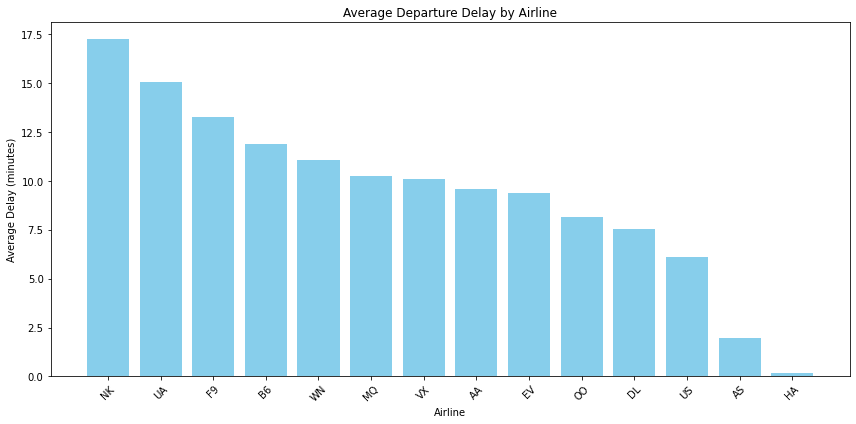

In [0]:
# Run the SQL query for average delays
avg_delay_df = spark.sql("""
SELECT AIRLINE, AVG(DEPARTURE_DELAY) AS AVG_DEPARTURE_DELAY
FROM flights
GROUP BY AIRLINE
ORDER BY AVG_DEPARTURE_DELAY DESC
""")

# Convert to Pandas DataFrame for matplotlib
avg_delay_pd = avg_delay_df.toPandas()

# Plot the average delay
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
plt.bar(avg_delay_pd['AIRLINE'], avg_delay_pd['AVG_DEPARTURE_DELAY'], color='skyblue')
plt.title('Average Departure Delay by Airline')
plt.xlabel('Airline')
plt.ylabel('Average Delay (minutes)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


## Average Departure Delay by Airline

The bar chart shows the average departure delay in minutes for various airlines. This data helps to understand the punctuality performance of different airlines.

### Key Observations:
- **NK (Spirit Airlines)** has the highest average departure delay, approximately 17.5 minutes.
- **UA (United Airlines)** follows with an average delay of around 15 minutes.
- **F9 (Frontier Airlines)**, **B6 (JetBlue Airways)**, and **WN (Southwest Airlines)** have moderate delays ranging from 10 to 13 minutes.
- **HA (Hawaiian Airlines)** has the lowest average delay, close to 0 minutes.
- Other airlines like **MQ (Envoy Air)**, **VX (Virgin America)**, **AA (American Airlines)**, **EV (ExpressJet Airlines)**, **OO (SkyWest Airlines)**, **DL (Delta Air Lines)**, **US (US Airways)**, and **AS (Alaska Airlines)** show varying levels of average delays between 5 and 10 minutes.

### Conclusion:
- The chart highlights the significant differences in average departure delays across airlines, which can be useful for travelers when selecting an airline based on punctuality. It also provides valuable insights for airline operations to identify areas for improvement.



**Visualize delay patterns over days of the week**

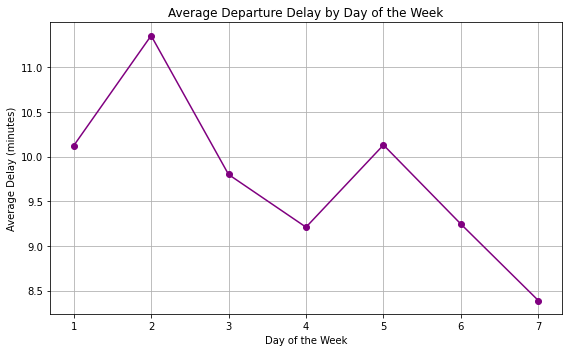

In [0]:
# Run SQL query for delay patterns by day of the week
delay_patterns_df = spark.sql("""
SELECT DAY_OF_WEEK, AVG(DEPARTURE_DELAY) AS AVG_DEPARTURE_DELAY
FROM flights
GROUP BY DAY_OF_WEEK
ORDER BY DAY_OF_WEEK
""")

# Convert to Pandas DataFrame
delay_patterns_pd = delay_patterns_df.toPandas()

# Plot the delay patterns
plt.figure(figsize=(8, 5))
plt.plot(delay_patterns_pd['DAY_OF_WEEK'], delay_patterns_pd['AVG_DEPARTURE_DELAY'], marker='o', color='purple')
plt.title('Average Departure Delay by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Average Delay (minutes)')
plt.grid()
plt.tight_layout()
plt.show()


## Average Departure Delay by Day of the Week


This line graph shows the average departure delay in minutes for each day of the week. The x-axis represents the days of the week, labeled from 1 to 7, while the y-axis represents the average delay in minutes, ranging from 8.5 to 11.5 minutes.

### Key Observations:
- **Highest Delay**: The highest average departure delay occurs on the second day of the week, reaching just above 11 minutes.
- **Decrease in Delays**: The delay decreases on the third and fourth days, reaching a low of around 9 minutes on the fourth day.
- **Slight Increase**: There is a slight increase in delays on the fifth day.
- **Lowest Delay**: The lowest average delay occurs on the seventh day, at around 8.5 minutes.

### Conclusion:
- The graph highlights the variation in average departure delays throughout the week, which can be useful for scheduling and operational planning in transportation or logistics.


**Visualize delay patterns by month**

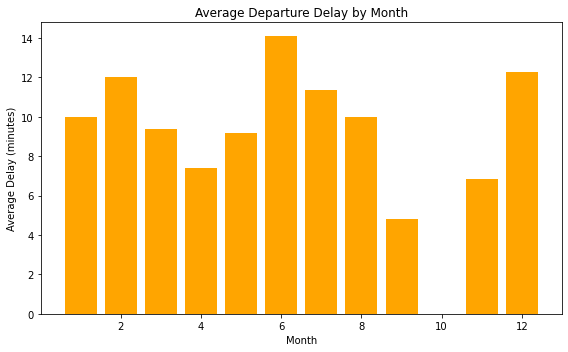

In [0]:
# Run SQL query for delay patterns by month
monthly_delay_df = spark.sql("""
SELECT MONTH, AVG(DEPARTURE_DELAY) AS AVG_DEPARTURE_DELAY
FROM flights
GROUP BY MONTH
ORDER BY MONTH
""")

# Convert to Pandas DataFrame
monthly_delay_pd = monthly_delay_df.toPandas()

# Plot the delay patterns
plt.figure(figsize=(8, 5))
plt.bar(monthly_delay_pd['MONTH'], monthly_delay_pd['AVG_DEPARTURE_DELAY'], color='orange')
plt.title('Average Departure Delay by Month')
plt.xlabel('Month')
plt.ylabel('Average Delay (minutes)')
plt.tight_layout()
plt.show()


## Average Departure Delay by Month


The bar chart shows the average departure delay in minutes for each month of the year. The x-axis represents the months (from 1 to 12), and the y-axis represents the average departure delay in minutes.

### Key Observations:
- **June**: The highest average departure delay occurs in June, with an average delay of around 14 minutes.
- **September**: The lowest average departure delay is observed in September, with an average delay of around 4 minutes.
- **Other Months**: The delays for other months fall between these two extremes, showing varying levels of average departure delays.

### Conclusion:
- This chart helps in understanding the seasonal patterns in departure delays. Airlines and airports can use this information for planning and improving operational efficiency, especially during months with higher delays.


### Question: Which airlines had the highest average delays?


#### Answer:

- **For Departure Delays:**
  The airline with the highest average departure delay is **NK (Spirit Airlines)** with an average delay of **17.23 minutes**.

- **For Arrival Delays:**
  The airline with the highest average arrival delay is **NK (Spirit Airlines)** with an average delay of **15.51 minutes**.

---




### What patterns did you observe in delays by day of the week?

### Key Observations:
- **Highest Delay**: The highest average departure delay occurs on the second day of the week, reaching just above 11 minutes.
- **Decrease in Delays**: The delay decreases on the third and fourth days, reaching a low of around 9 minutes on the fourth day.
- **Slight Increase**: There is a slight increase in delays on the fifth day.
- **Lowest Delay**: The lowest average delay occurs on the seventh day, at around 8.5 minutes.


